#  Importing Libraries

In [1]:
#Downloading Libraries
#Creating Enviroment
from sqlalchemy import create_engine
import pymysql
import pandas as pd
import numpy as np
from pandas import Series, DataFrame
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns 
sns.set_theme(style="darkgrid")
import pandas_profiling


#SK Learn stuff
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,classification_report
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.tree import plot_tree


%matplotlib inline

# Downloading Data

In [2]:
#Downloading Data
credit = pd.read_csv('CreditOne.csv', header = 204)

# HTML EDA Report

In [3]:
#Creating an HTML EDA Report
pandas_profiling.ProfileReport(credit)

Summarize dataset:   0%|          | 0/39 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

 HTML EDA Report Conclusions 
1. 25 Variables- 21 Num, 4 Catergorical
2. 30,000 Observations
3. Credit Limit - ranges from 10,000-1,000,000 
4. Gender - 60% of customers are female and 40% are male.
5. Education - 47% of customers attended university, 35% graduate school, 16% high school, and 2% other form of education
6.Civil Status - 53.2% of Customers are single, 45.5% are married, 1.1% are divorced and less than .2% have other status.
6. Age of customers ranges from 21-79 years old
5. 22.1% of the loans defaulted. 6636 defaulted loans.

# Data Preparation

In [4]:
#check for headers
credit.head(10)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,female,university,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,default
1,2,120000,female,university,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,default
2,3,90000,female,university,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,not default
3,4,50000,female,university,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,not default
4,5,50000,male,university,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,not default
5,6,50000,male,graduate school,2,37,0,0,0,0,...,19394,19619,20024,2500,1815,657,1000,1000,800,not default
6,7,500000,male,graduate school,2,29,0,0,0,0,...,542653,483003,473944,55000,40000,38000,20239,13750,13770,not default
7,8,100000,female,university,2,23,0,-1,-1,0,...,221,-159,567,380,601,0,581,1687,1542,not default
8,9,140000,female,high school,1,28,0,0,2,0,...,12211,11793,3719,3329,0,432,1000,1000,1000,not default
9,10,20000,male,high school,2,35,-2,-2,-2,-2,...,0,13007,13912,0,0,0,13007,1122,0,not default


In [5]:
# Check for nulls
nulls = credit.isnull().sum

In [6]:
# Drop duplicates
credit = credit.drop_duplicates()

In [7]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   ID                          30000 non-null  int64 
 1   LIMIT_BAL                   30000 non-null  int64 
 2   SEX                         30000 non-null  object
 3   EDUCATION                   30000 non-null  object
 4   MARRIAGE                    30000 non-null  int64 
 5   AGE                         30000 non-null  int64 
 6   PAY_0                       30000 non-null  int64 
 7   PAY_2                       30000 non-null  int64 
 8   PAY_3                       30000 non-null  int64 
 9   PAY_4                       30000 non-null  int64 
 10  PAY_5                       30000 non-null  int64 
 11  PAY_6                       30000 non-null  int64 
 12  BILL_AMT1                   30000 non-null  int64 
 13  BILL_AMT2                   30000 non-null  in

In [8]:
# Drop ID column is unnecessary (Mike's suggestions)
credit = credit.drop(['ID'], axis=1)

In [9]:
#Renaming Columns
#Inplace=True means that it will modify the input directly, without allocating any additional output.
credit.rename(columns={'default payment next month': 'Default_Status'}, inplace=True)
credit.rename(columns={'PAY_0': 'PAY_1'}, inplace=True)

In [10]:
#Replacing categorical values, with numeric values. This will convert sex,education and default_Status into integers
credit['SEX'].replace(['male','female'],[1,2], inplace=True) #1=male; 2=female
credit['EDUCATION'].replace(['graduate school', 'university', 'high school', 'other'], [1, 2, 3, 0],inplace=True)
credit['Default_Status'].replace(['default', 'not default'],[1,0],inplace=True) #1-default; 0-not defaulted

In [11]:
#Ensuring all features are integers
credit.dtypes

LIMIT_BAL         int64
SEX               int64
EDUCATION         int64
MARRIAGE          int64
AGE               int64
PAY_1             int64
PAY_2             int64
PAY_3             int64
PAY_4             int64
PAY_5             int64
PAY_6             int64
BILL_AMT1         int64
BILL_AMT2         int64
BILL_AMT3         int64
BILL_AMT4         int64
BILL_AMT5         int64
BILL_AMT6         int64
PAY_AMT1          int64
PAY_AMT2          int64
PAY_AMT3          int64
PAY_AMT4          int64
PAY_AMT5          int64
PAY_AMT6          int64
Default_Status    int64
dtype: object

In [12]:
#Binning Age for EDA and visualization purposes only
credit['AGE_BIN']=pd.cut(credit['AGE'],bins=[20,30,40,50,60,70,80], labels=['20-30', '30-40', '40-50', '50-60', '60-70', '70+'])
credit.AGE_BIN.unique()

['20-30', '30-40', '50-60', '40-50', '60-70', '70+']
Categories (6, object): ['20-30' < '30-40' < '40-50' < '50-60' < '60-70' < '70+']

In [13]:
credit.head()

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_1,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,Default_Status,AGE_BIN
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,689,0,0,0,0,1,20-30
1,120000,2,2,2,26,-1,2,0,0,0,...,3455,3261,0,1000,1000,1000,0,2000,1,20-30
2,90000,2,2,2,34,0,0,0,0,0,...,14948,15549,1518,1500,1000,1000,1000,5000,0,30-40
3,50000,2,2,1,37,0,0,0,0,0,...,28959,29547,2000,2019,1200,1100,1069,1000,0,30-40
4,50000,1,2,1,57,-1,0,-1,0,0,...,19146,19131,2000,36681,10000,9000,689,679,0,50-60


<AxesSubplot:ylabel='Frequency'>

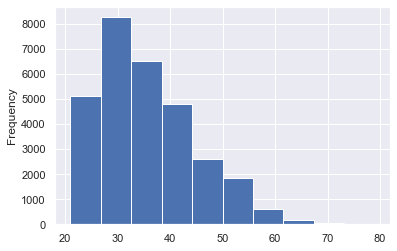

In [14]:
# histogram of bins for age
credit['AGE'].plot(kind='hist') 

# Investigative Questions:

Questions
How do you ensure that customers can/will pay their loans? 
Can we do this?
As you progress through the tasks at hand, begin thinking about how to solve this problem. Here are some lessons we learned form a similar problem we addressed last year:

We cannot control customer spending habits
We cannot always go from what we find in our analysis to the underlying "why"
We must focus on the problem(s) we can solve: What attributes in the data can we deem to be statistically significant to the problem at hand?
What concrete information can we derive from the data we have?
What proven methods can we use to uncover more information and why?

# Balance Limit Analysis

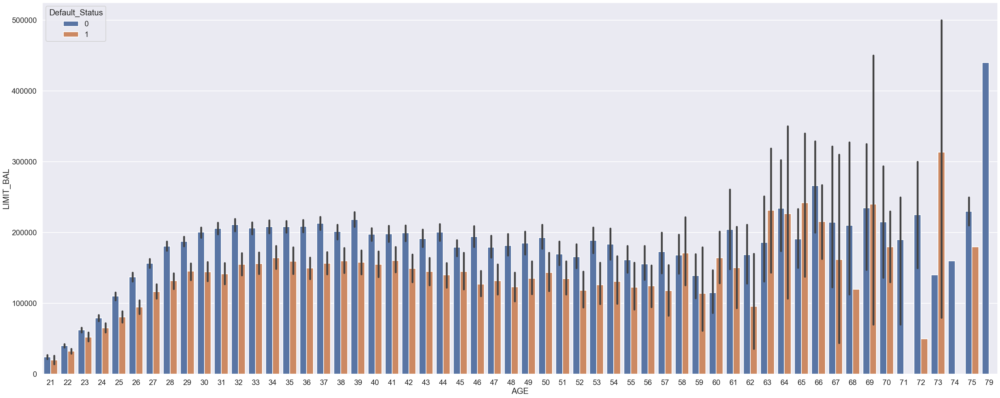

In [15]:
plt.figure(figsize=(50,20))
sns.set_context('poster')
fg = sns.barplot(x="AGE", y="LIMIT_BAL", data=credit, hue="Default_Status")

Insights - Highest defaulted loan 73 year old adutls that have credit limits higher than $ 200,000

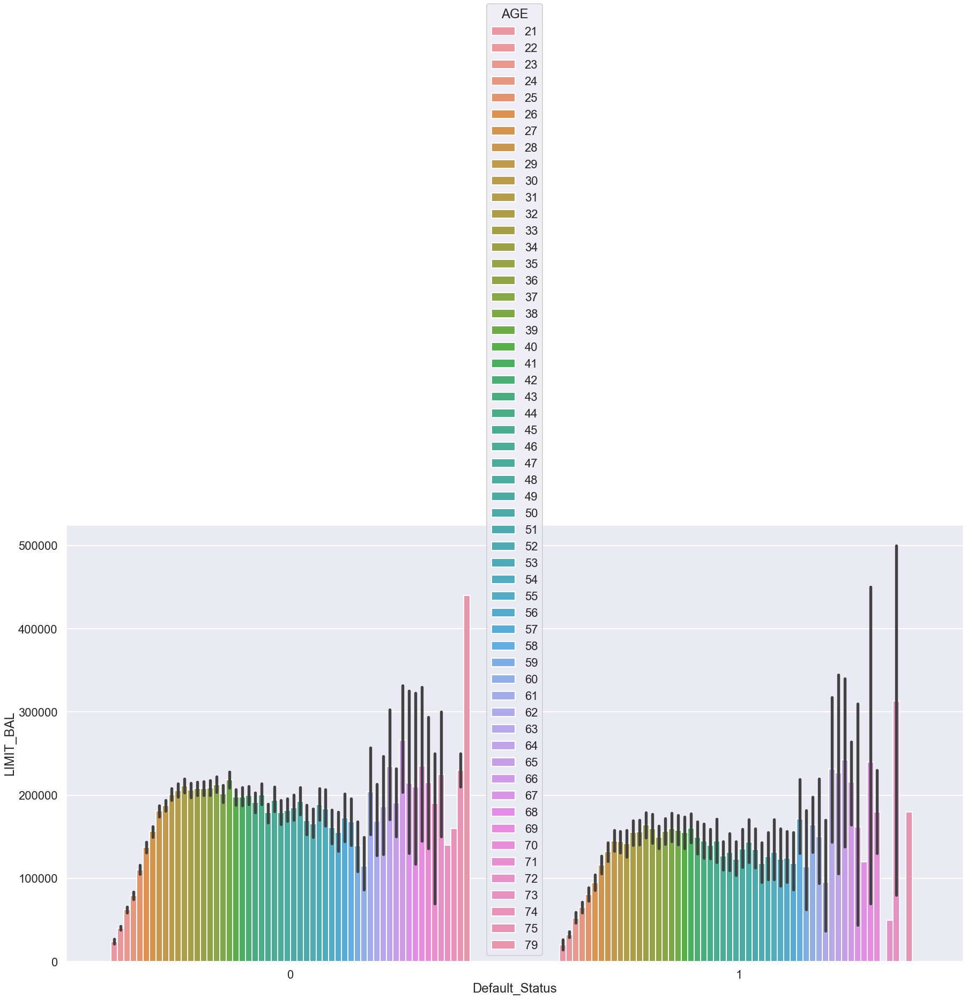

In [16]:
#This plot confirm the insight above
plt.figure(figsize=(30,15))
sns.set_context('poster')
fg = sns.barplot(x="Default_Status", y="LIMIT_BAL", hue="AGE", data=credit)

# Age Analysis

In [17]:
credit.groupby(['AGE_BIN','Default_Status','MARRIAGE']) ['Default_Status'].count()

AGE_BIN  Default_Status  MARRIAGE
20-30    0               0             10
                         1           1393
                         2           7107
                         3             32
         1               0              2
                         1            488
                         2           1969
                         3             12
30-40    0               0             22
                         1           4483
                         2           3956
                         3             63
         1               0              0
                         1           1239
                         2            934
                         3             16
40-50    0               0             12
                         1           3337
                         2           1164
                         3             93
         1               0              3
                         1           1025
                         2            338


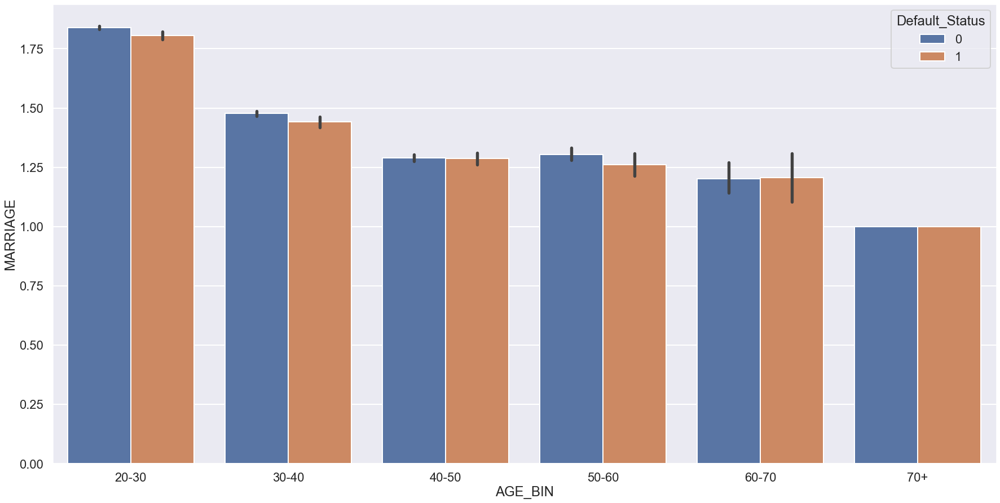

In [18]:
#This plot confirm the insight above
plt.figure(figsize=(30,15))
sns.set_context('poster')
fg = sns.barplot(x="AGE_BIN", y="MARRIAGE", hue="Default_Status", data=credit)

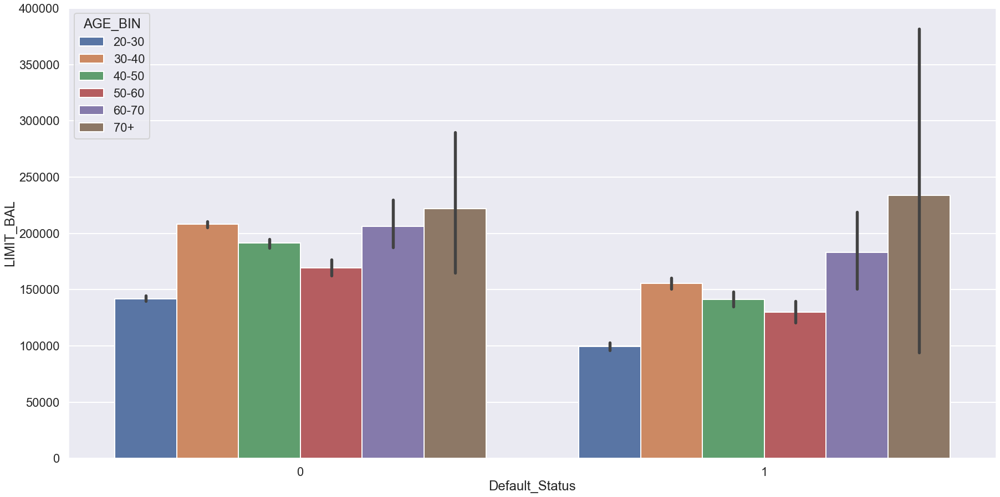

In [19]:
#This plot confirm the insight above
plt.figure(figsize=(30,15))
sns.set_context('poster')
fg = sns.barplot(x="Default_Status", y="LIMIT_BAL", hue="AGE_BIN", data=credit)

In [20]:
# Loans to adults older than 60 years are a higher risk to default, if credit limit is higher than $400,000

# Education Analysis

In [21]:
credit.groupby(['EDUCATION','Default_Status']) ['Default_Status'].sum()

EDUCATION  Default_Status
0          0                    0
           1                   33
1          0                    0
           1                 2036
2          0                    0
           1                 3330
3          0                    0
           1                 1237
Name: Default_Status, dtype: int64

In [22]:
credit.groupby(['EDUCATION','Default_Status']) ['Default_Status'].count()

EDUCATION  Default_Status
0          0                   435
           1                    33
1          0                  8549
           1                  2036
2          0                 10700
           1                  3330
3          0                  3680
           1                  1237
Name: Default_Status, dtype: int64

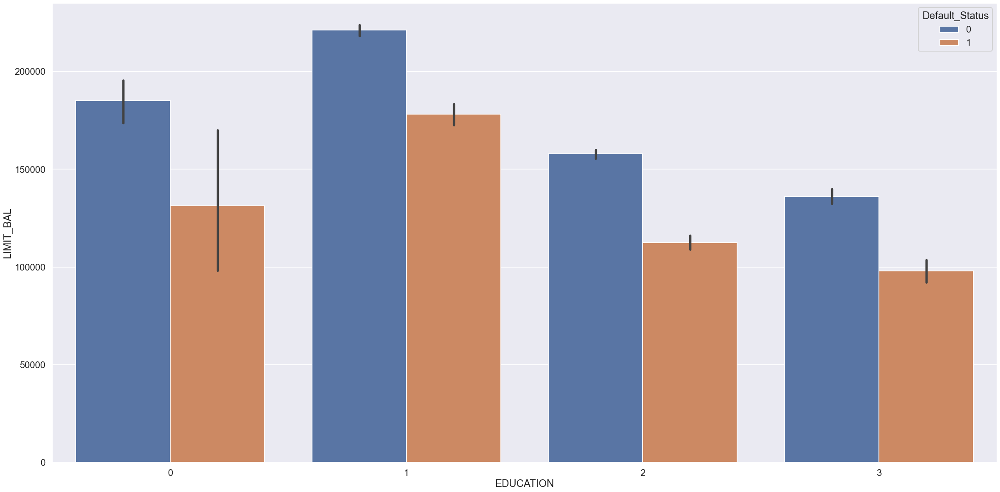

In [23]:
plt.figure(figsize=(40,20))
sns.set_context('poster')
fg = sns.barplot(x="EDUCATION", y="LIMIT_BAL", data=credit, hue="Default_Status")

# Gender Analysis

In [24]:
# Number of men and women in each of the passenger class
credit.groupby(['SEX', 'Default_Status'])['SEX'].count()

SEX  Default_Status
1    0                  9015
     1                  2873
2    0                 14349
     1                  3763
Name: SEX, dtype: int64

C:\Users\memcc\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


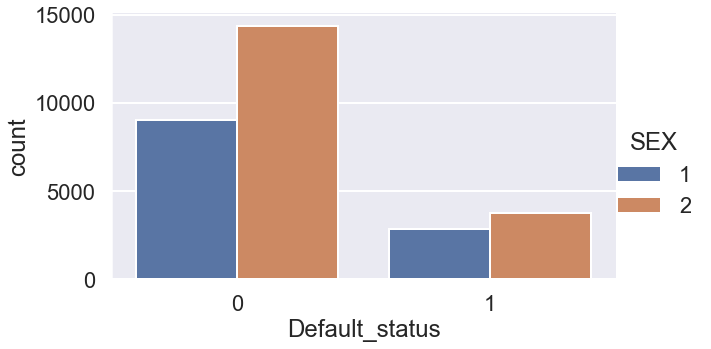

In [25]:
# Again use saeborn to group by Sex and class
g = sns.catplot('Default_Status', data=credit, hue='SEX', kind='count', aspect=1.75)
g.set_xlabels('Default_status')

In [26]:
# Number of passengers who survived in each class grouped by sex. Also total was found for each class grouped by sex.
credit.pivot_table('EDUCATION', 'SEX', 'Default_Status', aggfunc=np.sum, margins=True)

Default_Status,0,1,All
SEX,,,
1,15715,5357,21072
2,25274,7050,32324
All,40989,12407,53396


# Marital Status Analysis

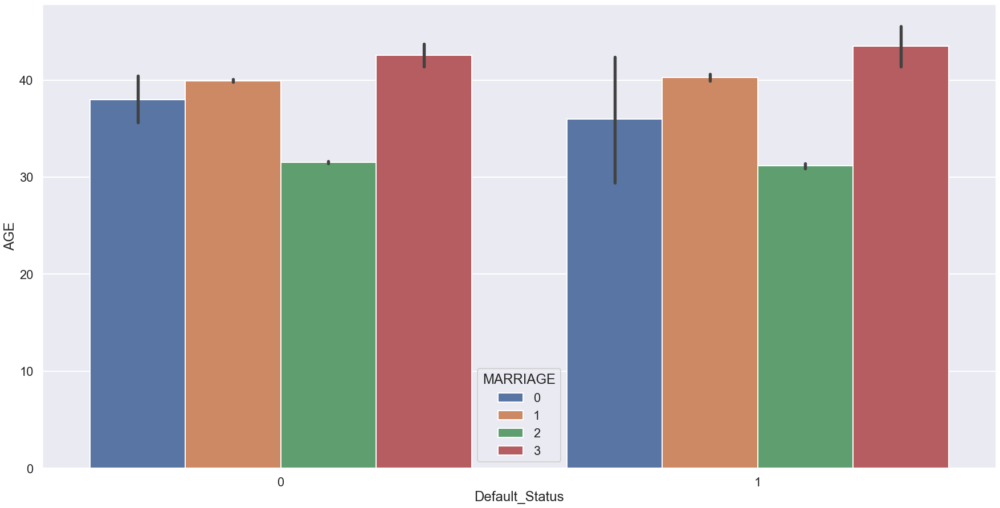

In [27]:
#This plot confirm the insight above
plt.figure(figsize=(30,15))
sns.set_context('poster')
fg = sns.barplot(x="Default_Status", y="AGE", hue="MARRIAGE", data=credit)

Highest Defaulted loans were from divorced 40 year old, but so were the not defaulted loans. 

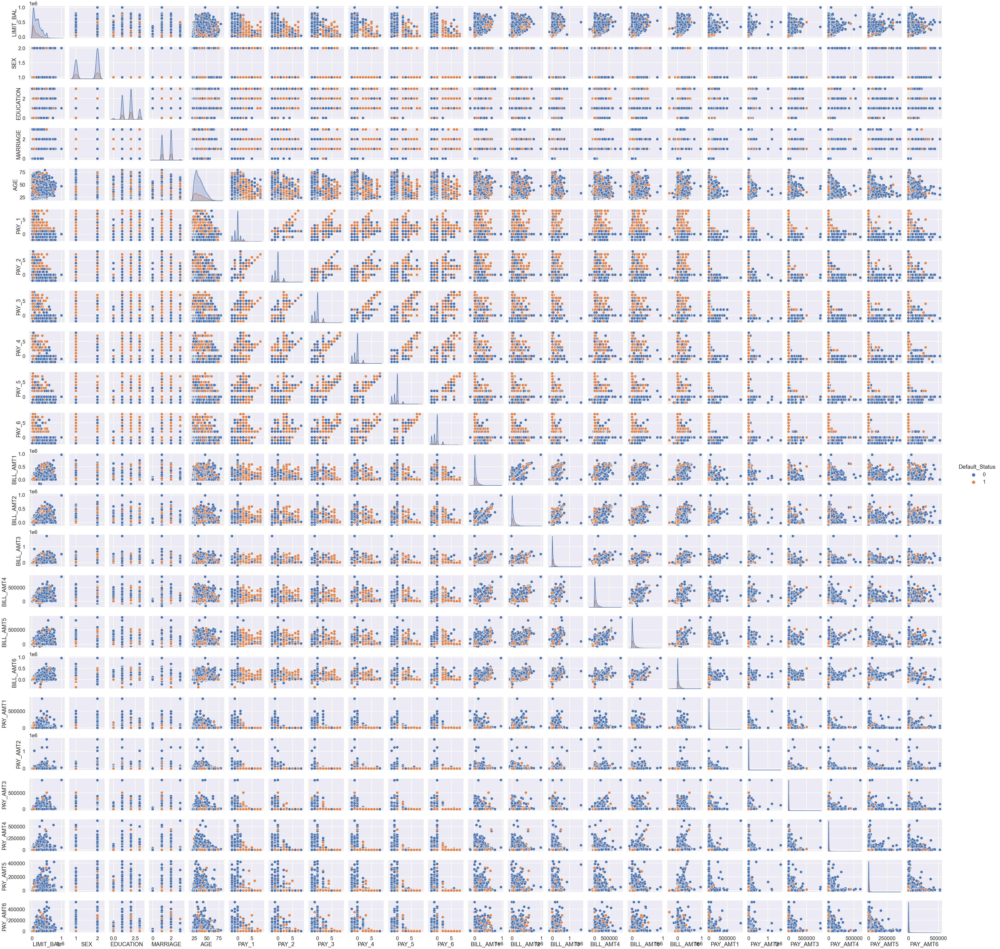

In [31]:
sns.pairplot(credit, hue="Default_Status")